In [2]:
from statistics import mean, stdev

import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks

from src.preprocessing.shared.filters import FilterPressureWithinBounds
from src.vitaldb.casegenerator import VitalFileOptions, VitalDBGenerator
from src.vitaldb.fetchingstrategy.DatasetApi import DatasetApi
import pandas as pd
import heartpy as hp

 Get a sample

In [3]:
# 3: shows a bad reading example
# 7: good filtering difference example
track = VitalDBGenerator(VitalFileOptions(['SNUADC/ART'], 1/500), DatasetApi(), [7]).next()

print(pd.DataFrame(track))

               0
0       -2.88494
1       -3.87240
2       -3.87240
3       -3.87240
4       -3.87240
...          ...
7884596 -5.84731
7884597 -5.84731
7884598 -5.84731
7884599 -5.84731
7884600      NaN

[7884601 rows x 1 columns]


In [4]:
track_trimmed = [x[0] for x in track if not np.isnan(x)]

print(pd.DataFrame(track_trimmed))

               0
0       -2.88494
1       -3.87240
2       -3.87240
3       -3.87240
4       -3.87240
...          ...
7876998 -5.84731
7876999 -5.84731
7877000 -5.84731
7877001 -5.84731
7877002 -5.84731

[7877003 rows x 1 columns]


Signal filtering

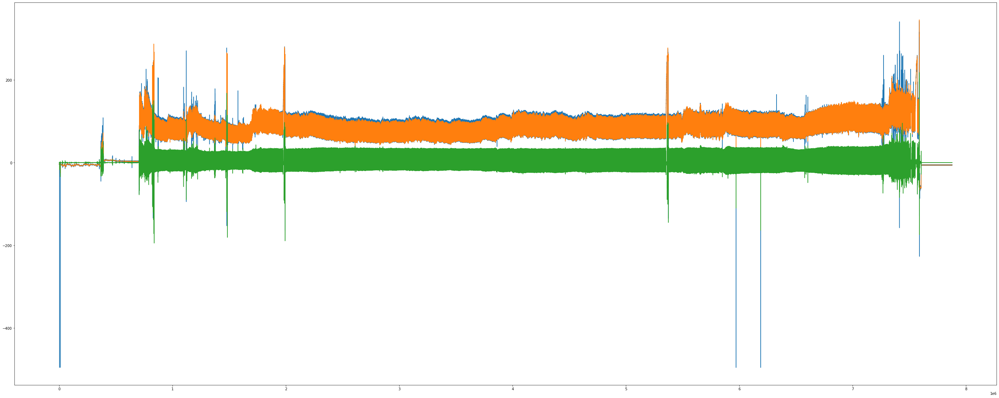

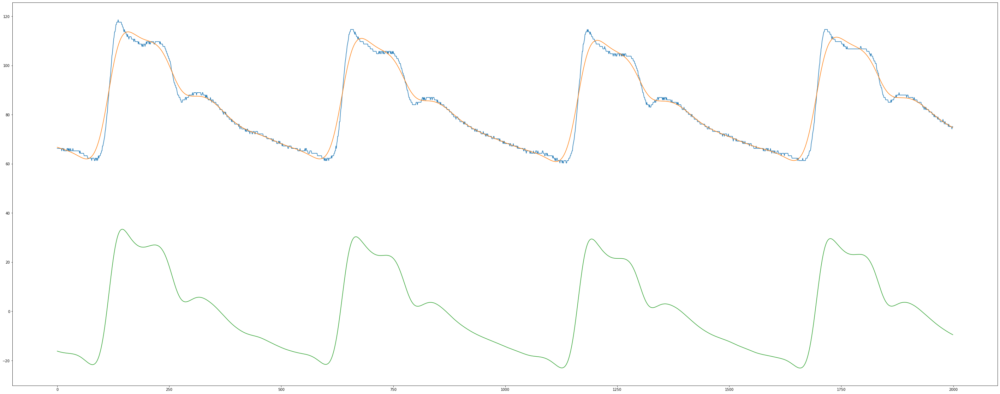

In [5]:
track_lowpass = hp.filter_signal(data=track_trimmed, cutoff=5, sample_rate=500, filtertype='lowpass')
track_bandpass  = hp.filter_signal(data=track_trimmed, cutoff=[0.1, 8], sample_rate=500, filtertype='bandpass')

plt.figure(figsize=(50,20))
plt.plot(track_trimmed)
plt.plot(track_lowpass)
plt.plot(track_bandpass)
plt.show()

plt.figure(figsize=(50,20))
plt.plot(track_trimmed[4000000:4002000])
plt.plot(track_lowpass[4000000:4002000])
plt.plot(track_bandpass[4000000:4002000])
plt.show()

Extract heartbeats

In [6]:
working_data, measure = hp.process(track_lowpass, 500)

heartbeats_indices = []
for start, middle, end in zip(working_data['peaklist'][:-2], working_data['peaklist'][1:-1], working_data['peaklist'][2:]):
    if not (start in working_data['removed_beats'] or middle in working_data['removed_beats'] or end in working_data['removed_beats']):
        start_beat = start+np.argmin(track_lowpass[start:middle])
        end_beat = middle+np.argmin(track_lowpass[middle:end])
        heartbeats_indices.append((start_beat, end_beat))

print(pd.DataFrame(heartbeats_indices))

             0        1
0       707421   707932
1       707932   708450
2       708450   708953
3       708953   709469
4       709469   709997
...        ...      ...
15401  7586600  7586968
15402  7586968  7587352
15403  7587352  7587766
15404  7588442  7588913
15405  7588913  7589483

[15406 rows x 2 columns]


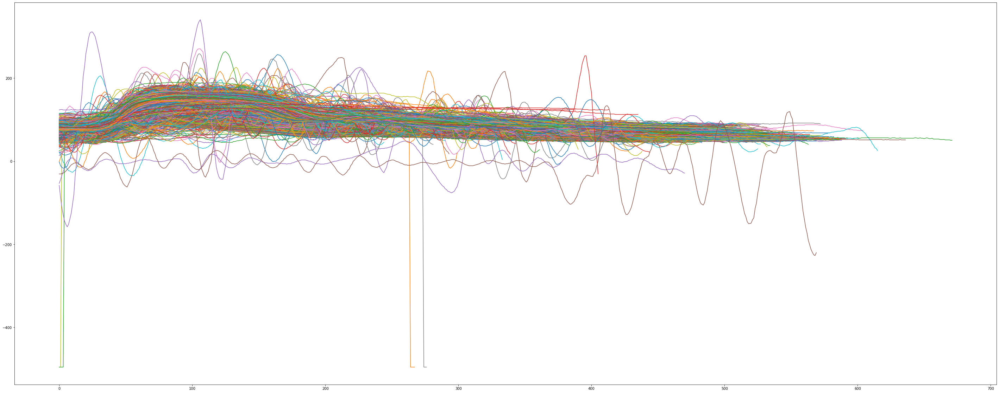

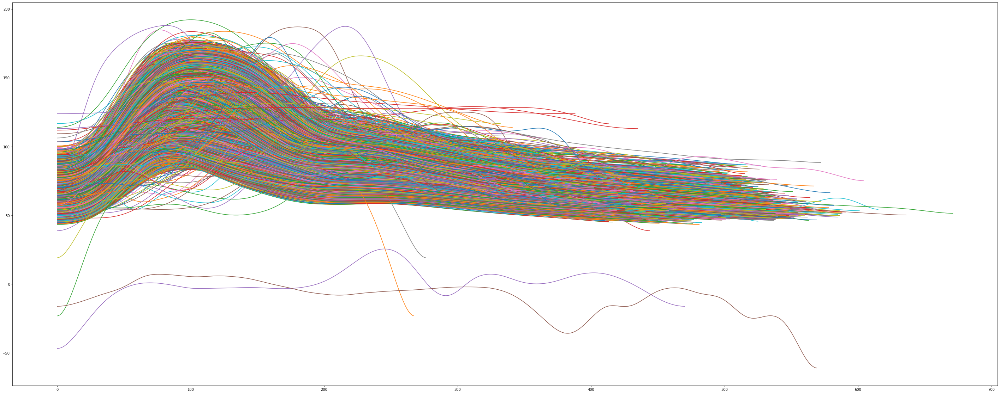

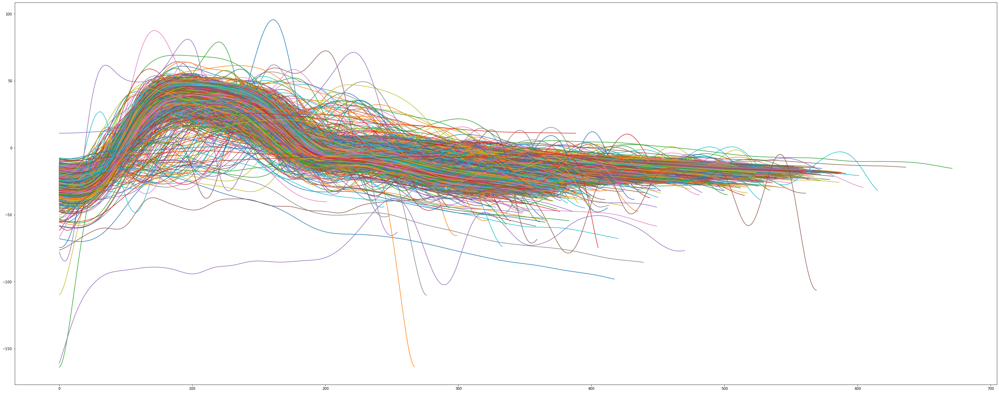

In [7]:
heartbeat_unfiltered = [track_trimmed[i[0]:i[1]] for i in heartbeats_indices]
heartbeat_lowpass = [track_lowpass[i[0]:i[1]] for i in heartbeats_indices]
heartbeat_bandpass = [track_bandpass[i[0]:i[1]] for i in heartbeats_indices]

def plot_heartbeats(beats):
    plt.figure(figsize=(50,20))
    for beat in beats:
        plt.plot(beat)
    plt.show()

plot_heartbeats(heartbeat_unfiltered)
plot_heartbeats(heartbeat_lowpass)
plot_heartbeats(heartbeat_bandpass)

Filter pressure within bounds

In [8]:
def pressure_within_bounds(beat, min_pressure, max_pressure) -> bool:
    return min(beat) > min_pressure and max(beat) < max_pressure

heartbeat_indices_filtered = []
for beat_index in heartbeats_indices:
    if FilterPressureWithinBounds(30, 230).filter(track_lowpass[beat_index[0]:beat_index[1]], [min(track_lowpass[beat_index[0]:beat_index[1]]), max(track_lowpass[beat_index[0]:beat_index[1]])]):
        heartbeat_indices_filtered.append(beat_index)

print(pd.DataFrame(heartbeats_indices))
print(pd.DataFrame(heartbeat_indices_filtered))

             0        1
0       707421   707932
1       707932   708450
2       708450   708953
3       708953   709469
4       709469   709997
...        ...      ...
15401  7586600  7586968
15402  7586968  7587352
15403  7587352  7587766
15404  7588442  7588913
15405  7588913  7589483

[15406 rows x 2 columns]
             0        1
0       707421   707932
1       707932   708450
2       708450   708953
3       708953   709469
4       709469   709997
...        ...      ...
15399  7581595  7582046
15400  7586234  7586600
15401  7586600  7586968
15402  7586968  7587352
15403  7587352  7587766

[15404 rows x 2 columns]


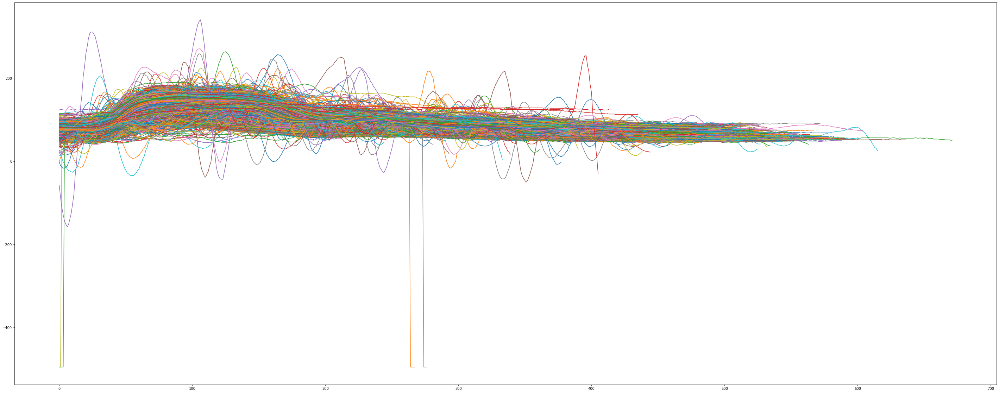

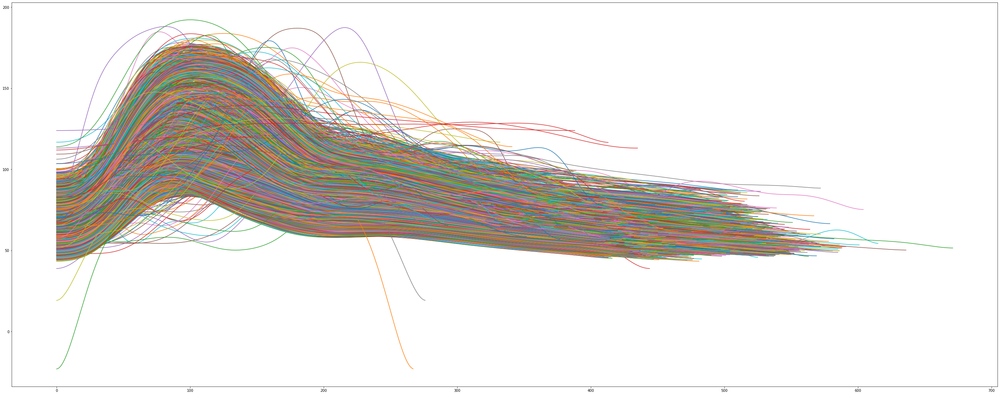

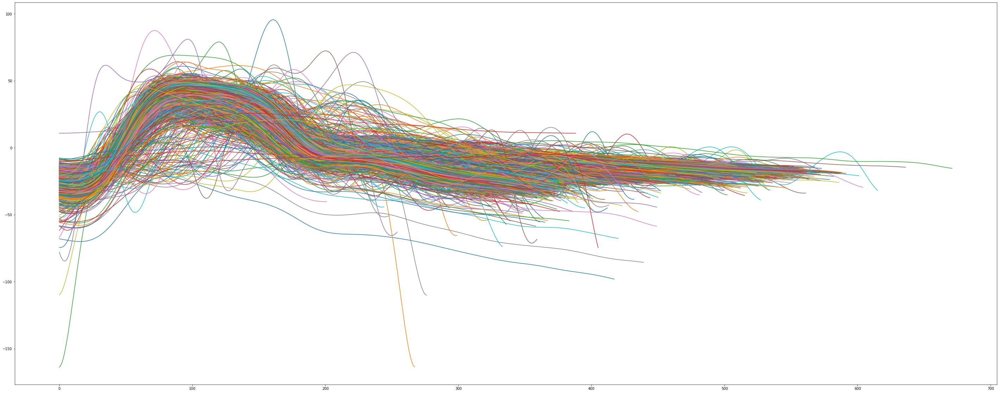

In [9]:
heartbeat_unfiltered_filtered = [track_trimmed[i[0]:i[1]] for i in heartbeat_indices_filtered]
heartbeat_lowpass_filtered = [track_lowpass[i[0]:i[1]] for i in heartbeat_indices_filtered]
heartbeat_bandpass_filtered = [track_bandpass[i[0]:i[1]] for i in heartbeat_indices_filtered]

plot_heartbeats(heartbeat_unfiltered_filtered)
plot_heartbeats(heartbeat_lowpass_filtered)
plot_heartbeats(heartbeat_bandpass_filtered)

Filter beats with many peaks

In [10]:
heartbeat_indices_peaks = []
for beat_index in heartbeat_indices_filtered:
    beat_bandpass = track_bandpass[beat_index[0]:beat_index[1]]
    peaks, properties = find_peaks(beat_bandpass)
    if len(peaks) < 3:
        heartbeat_indices_peaks.append(beat_index)

print(pd.DataFrame(heartbeat_indices_filtered))
print(pd.DataFrame(heartbeat_indices_peaks))

             0        1
0       707421   707932
1       707932   708450
2       708450   708953
3       708953   709469
4       709469   709997
...        ...      ...
15399  7581595  7582046
15400  7586234  7586600
15401  7586600  7586968
15402  7586968  7587352
15403  7587352  7587766

[15404 rows x 2 columns]
             0        1
0       707421   707932
1       707932   708450
2       711549   712067
3       712584   713095
4       713095   713589
...        ...      ...
14154  7579400  7579789
14155  7581290  7581595
14156  7586234  7586600
14157  7586600  7586968
14158  7586968  7587352

[14159 rows x 2 columns]


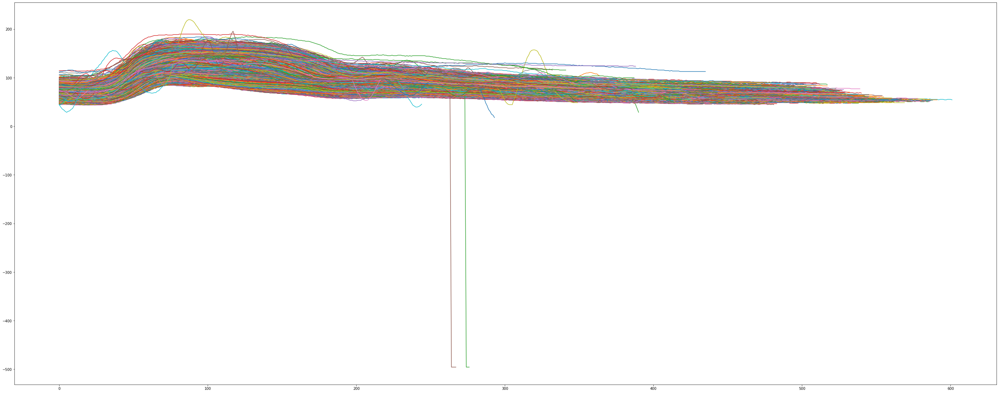

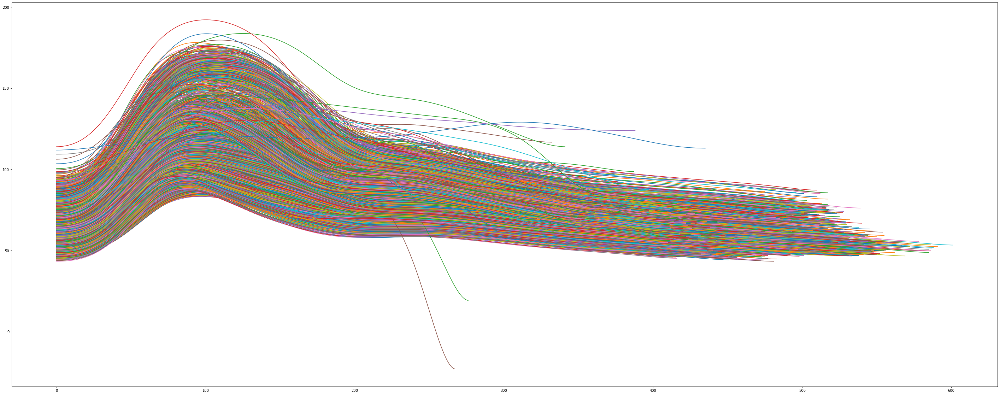

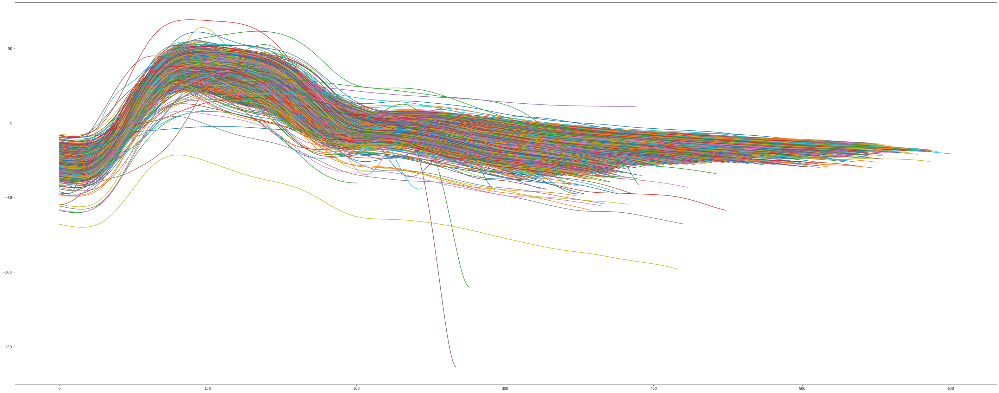

In [11]:
heartbeat_unfiltered_peaks = [track_trimmed[i[0]:i[1]] for i in heartbeat_indices_peaks]
heartbeat_lowpass_peaks = [track_lowpass[i[0]:i[1]] for i in heartbeat_indices_peaks]
heartbeat_bandpass_peaks = [track_bandpass[i[0]:i[1]] for i in heartbeat_indices_peaks]

plot_heartbeats(heartbeat_unfiltered_peaks)
plot_heartbeats(heartbeat_lowpass_peaks)
plot_heartbeats(heartbeat_bandpass_peaks)

Pad ending

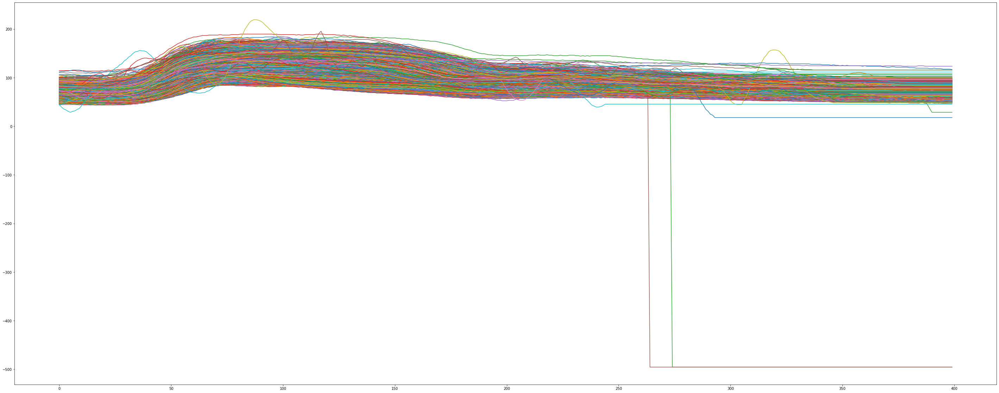

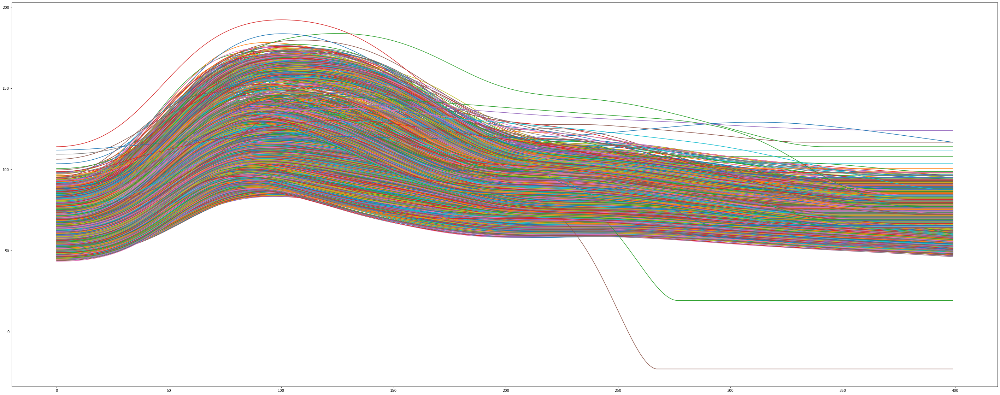

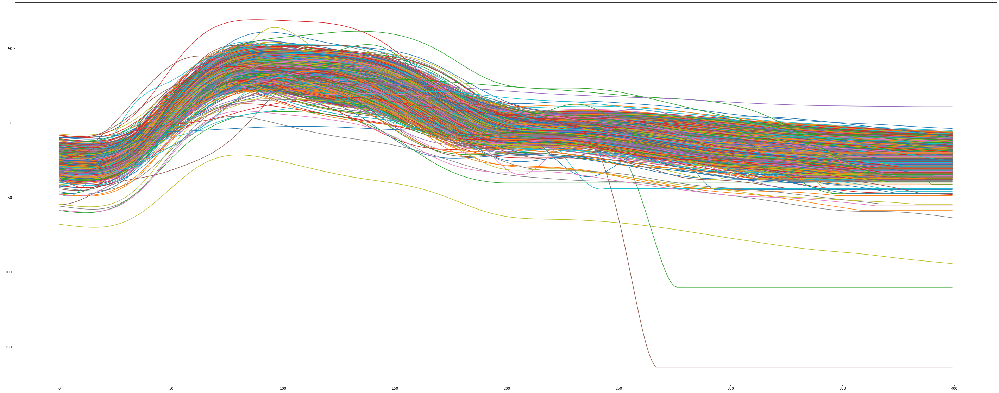

In [12]:
def resize_beat(beat, length):
    missing_length = length - len(beat)
    if missing_length > 0:
        last_element = beat[-1]
        padding = [last_element] * missing_length
        return np.append(beat, padding)
    else:
        return beat[0:length]

heartbeat_unfiltered_resized = [resize_beat(x, 400) for x in heartbeat_unfiltered_peaks]
heartbeat_lowpass_resized = [resize_beat(x, 400) for x in heartbeat_lowpass_peaks]
heartbeat_bandpass_resized = [resize_beat(x, 400) for x in heartbeat_bandpass_peaks]

plot_heartbeats(heartbeat_unfiltered_resized)
plot_heartbeats(heartbeat_lowpass_resized)
plot_heartbeats(heartbeat_bandpass_resized)

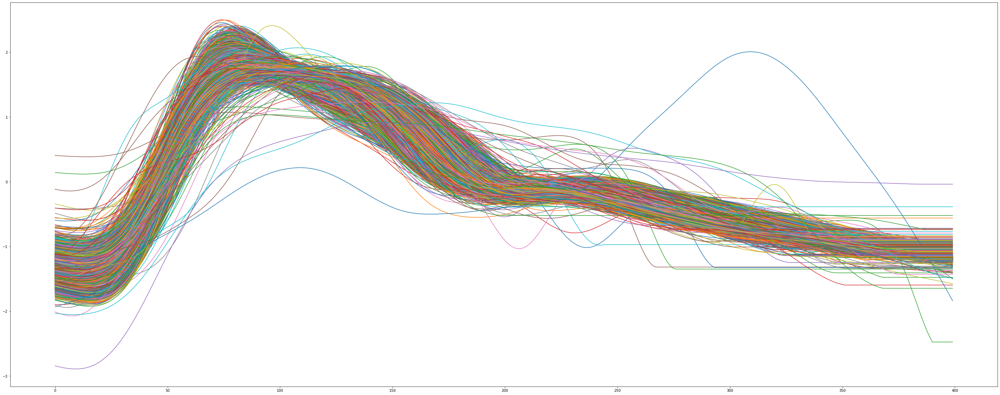

In [13]:
def standard_scaling(beat):
    _mean = mean(beat)
    std = stdev(beat)

    return (beat-_mean)/std

heartbeat_bandpass_scaled = [standard_scaling(x) for x in heartbeat_bandpass_resized]

plot_heartbeats(heartbeat_bandpass_scaled)